# Team Members

- Pranay Bhaskar Mallipudi
- Pratik Khadse

# Libraries

In [1]:
# !pip install pmdarima
# !pip install -U numba
# !pip install statsforecast
# !pip install --pre pycaret
# !pip install --force-reinstall xgboost==1.1.0

In [2]:
import numpy as np # mathematical formulas
import pandas as pd # dataframe
import matplotlib.pyplot as plt # Visualization
import statsmodels.api as sm # For modeling
from statsmodels.tsa.stattools import adfuller,kpss,acf # Stationarity Tests
from statsmodels.tsa.arima.model import ARIMA # Time series modeling
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf # ACF, PACF Plots
import pmdarima as pmd # Time series modeling
from pmdarima import model_selection # Auto ARIMA
from sklearn.metrics import mean_squared_error #MSE
from sklearn.metrics import  mean_absolute_percentage_error # MAPE
import pandas_datareader as pdr # For reading files
from plotnine import * # Visualization
import datetime as dt # for datetime
import holidays # for US Holidays
from pycaret.time_series import * # time series modeling
import plotly.express as px # Visualization
import pickle # for saving model objects
from google.colab import files # for saving files
from datetime import datetime

from sklearn.metrics import mean_squared_error
import statsmodels.formula.api as smf
from xgboost import XGBRegressor
from sklearn.model_selection import GridSearchCV

# Import Data

In [ ]:
# Read file
df = pd.read_csv('https://raw.githubusercontent.com/robertasgabrys/Forecasting/main/Competition_Data.csv')

In [ ]:
# Review file, info and descriptive stats for reference
display(df.head())
display(df.info())
display(df.describe())

,DateTime,Date,Hour,Temperature,Load
0,1/1/2008 1:00,1/1/2008,1,25.0,10737.0
1,1/1/2008 2:00,1/1/2008,2,24.0,10348.0
2,1/1/2008 3:00,1/1/2008,3,23.0,9997.0
3,1/1/2008 4:00,1/1/2008,4,23.0,9760.0
4,1/1/2008 5:00,1/1/2008,5,23.0,9624.0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43848 entries, 0 to 43847
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   DateTime     43848 non-null  object 
 1   Date         43848 non-null  object 
 2   Hour         43848 non-null  int64  
 3   Temperature  43848 non-null  float64
 4   Load         35064 non-null  float64
dtypes: float64(2), int64(1), object(2)
memory usage: 1.7+ MB


None

,Hour,Temperature,Load
count,43848.000000,43848.000000,35064.000000
mean,12.500000,50.334529,11639.447525
std,6.922265,20.490564,2317.204003
min,1.000000,-17.330000,7223.000000
25%,6.750000,34.330000,9962.000000
50%,12.500000,51.000000,11450.000000
75%,18.250000,67.000000,12811.000000
max,24.000000,101.000000,23753.000000


# Data Cleaning & Variable Creation

In [ ]:
# Convert date dtype to datetime
df["Date"] = pd.to_datetime(df["Date"], format='%m/%d/%Y')

# Convert datetime dtype to datetime
df["DateTime"] = pd.to_datetime(df["DateTime"], format = "%m/%d/%Y %H:%M")

# Get day of week
df["day_of_week"] = df["Date"].dt.dayofweek

# Get Quarter
df["quarter"] = df["Date"].dt.quarter

# Get Month
df["month"] = df["Date"].dt.month


# Get National Holidays
us_holidays = holidays.US()
df["us_holidays"] = df["Date"].isin(us_holidays)
df["us_holidays"] = df["us_holidays"].astype("int")

# Drop date
date = df[["Date"]]
df = df.drop(["Date"], axis = 1)

# review
df.head()

#create index for trend
df['Index'] = range(1,len(df)+1)

In [ ]:
# Prepare data for further analysis: seperate validation data
df_overall = df.copy()
df_validation = df[df["Load"].isna()].copy()
df = df.dropna()

# Visualize

<AxesSubplot:xlabel='month'>

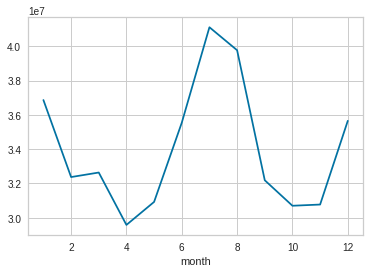

In [ ]:
# visualize monthly load: total load per month
df.groupby('month')['Load'].sum().plot()

<AxesSubplot:xlabel='month'>

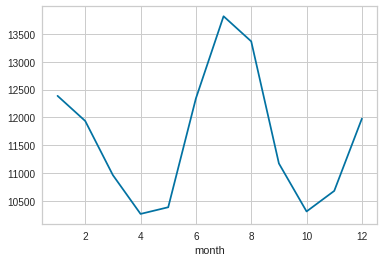

In [ ]:
# visualize monthly load: average load per month
df.groupby('month')['Load'].mean().plot()

In [ ]:
# Visualize Load time series
fig = px.line(df, x = df["DateTime"], y = df["Load"], width = 2000, height = 600)
fig.update_xaxes(rangeslider_visible = True)
fig.show()

In [ ]:
# Visualize colouring months 
fig = px.line(df, x = df["DateTime"], y = df["Load"], color = df["month"], width = 2000, height = 600)
fig.update_xaxes(rangeslider_visible = True)
fig.show()

In [ ]:
# Visualize colouring quarter 
fig = px.line(df, x = df["DateTime"], y = df["Load"], color = df["quarter"], width = 2000, height = 600)
fig.update_xaxes(rangeslider_visible = True)
fig.show()

In [ ]:
# Visualize colouring dayofweek 
fig = px.line(df, x = df["DateTime"], y = df["Load"], color = df["day_of_week"], width = 2000, height = 600)
fig.update_xaxes(rangeslider_visible = True)
fig.show()

In [ ]:
# Visualize colouring hour 
fig = px.line(df, x = df["DateTime"], y = df["Load"], color = df["Hour"], width = 2000, height = 600)
fig.update_xaxes(rangeslider_visible = True)
fig.show()

**Observations:-**
- if we closely zoom in the data, there's a daily and weekly and monthly seasaonlity in the data.
- consumption is less in weekends than in weekdays
- daily, the energy consumption peaks at around 7pm and lowest at 5am
- consumption is highest in hotter months like july and lowest in colder months
- There also seems to be a slightly rising trend, due to increasing global temperatures


In [ ]:
# Visualize Temperature time series
fig = px.line(df, x = df["DateTime"], y = df["Temperature"], width = 2000, height = 600)
fig.update_xaxes(rangeslider_visible = True)
fig.show()

In [ ]:
# # Visualize colouring months 
# fig = px.line(df, x = df["DateTime"], y = df["Temperature"], color = df["month"], width = 2000, height = 600)
# fig.update_xaxes(rangeslider_visible = True)
# fig.show()

In [ ]:
# # Visualize colouring quarter 
# fig = px.line(df, x = df["DateTime"], y = df["Temperature"], color = df["quarter"], width = 2000, height = 600)
# fig.update_xaxes(rangeslider_visible = True)
# fig.show()

In [ ]:
# # Visualize colouring dayofweek 
# fig = px.line(df, x = df["DateTime"], y = df["Temperature"], color = df["day_of_week"], width = 2000, height = 600)
# fig.update_xaxes(rangeslider_visible = True)
# fig.show()

In [ ]:
# # Visualize colouring hour 
# fig = px.line(df, x = df["DateTime"], y = df["Temperature"], color = df["Hour"], width = 2000, height = 600)
# fig.update_xaxes(rangeslider_visible = True)
# fig.show()

# Stationarity Tests

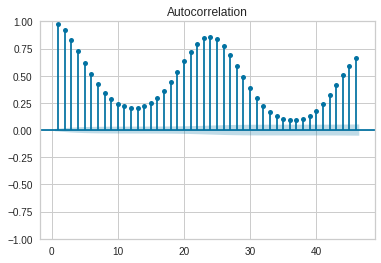

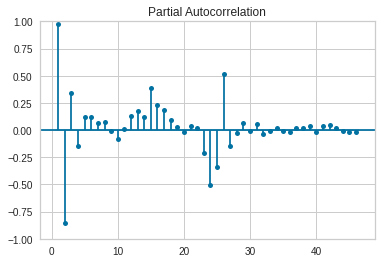

In [ ]:
# Plot ACF and PACF for Load

plot_acf(df['Load'],missing='drop',zero=False);
plot_pacf(df['Load'].dropna(),zero=False);

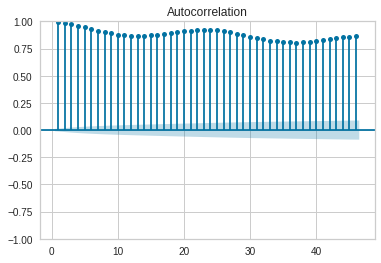

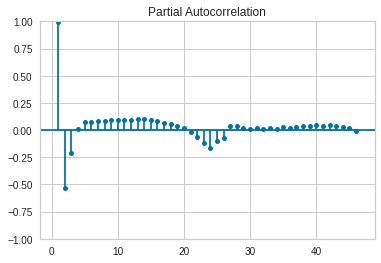

In [ ]:
# Plot ACF and PACF for Temperature

plot_acf(df['Temperature'],missing='drop',zero=False);
plot_pacf(df['Temperature'].dropna(),zero=False);


## Dickey Fuller Test

In [ ]:
# Dickey-Fuller test
# Ho: data is NOT stationary (data follos unit root process)
# Ha: data is stationary
# We assume Ho is true
# Decision/conclusion: If p-value < 0.05, we reject Ho and conclude Ha, i.e. the data is stationary and 
# we can build and ARMA model
# If p-value > 0.05, we fail to reject Ho and conclude that the data is not stationary and
# diffrencing needs to be performed to transform not stationary data to stationary and then build 
# an ARMA model


p_value_load = adfuller(df['Load'].dropna())[1]
print(p_value_load)



6.56413846525963e-23


- ADF Result: Load is trend stationary

## KPSS Test

In [ ]:
# Kwiatkowski-Phillips-Schmidt-Shin (KPSS) Test
# A key difference from ADF test is the null hypothesis of the KPSS test is that the series is stationary.
# Ho: Data is stationary: the series is stationary around a deterministic trend (trend-stationary)
# Ha: Data is not stationary, the series has a unit root
p_value_load = kpss(df['Load'].dropna(), regression='c', nlags="auto")[1]
print(p_value_load)

0.1


- KPSS Result 1: Load is level stationary

In [ ]:
p_value_load = kpss(df['Load'].dropna(), regression='ct', nlags="auto")[1]
print(p_value_load)

0.01


- KPSS Result 2: Load is not trend stationary

# Corrections

In [ ]:
# Determine the order of differencing using pmd library:
pmd.arima.ndiffs(df['Load'], alpha=0.05, test='kpss', max_d=2)

1

In [ ]:
n_adf = pmd.arima.ndiffs(df['Load'], test="adf")
n_kpss = pmd.arima.ndiffs(df['Load'], test="kpss")
n_diffs = {"ADF ndiff":n_adf, "KPSS ndiff":n_kpss}
n_diffs

{'ADF ndiff': 0, 'KPSS ndiff': 1}

- Both ADF and KPSS recommend a non-seasonal differencing of 1

In [ ]:
# Determine the order of seasonal differencing, D in ARIMA(p,d,q)(P,D,Q), using pmd library:


# Osborn-Chui-Smith-Birchenhall OCSB Test:
# Null hypothesis: the series contains a seasonal unit root, i.e. data is not seasonally stationary
# It uses a Dickey-Fuller type regression.

# OCSB test that returns the recommended order of seasonal differencing:
# since data is hourly: m = 365.25*4
n_ocsb = pmd.arima.OCSBTest(m=8766).estimate_seasonal_differencing_term(df['Load'])
n_ocsb


0

In [ ]:
# # Canova-Hansen Test for Seasonal Stability:
# # Null hypothesis: the seasonal pattern is stable over time
# # CH test that returns the recommended order of seasonal differencing:

# n_ch = pmd.arima.CHTest(m=12).estimate_seasonal_differencing_term(df['Load'])
# n_ch

In [ ]:
# nsdiffs = number of seasonal differences
pmd.arima.nsdiffs(x = df['Load'], m = 8766, max_D=2, test='ocsb')

0

In [ ]:
# pmd.arima.nsdiffs(x = df['Load'], m = 12, max_D=2, test='ch')

- All the seasonal tests recommend that seasonal differencing is not required

In [ ]:
# Take difference and test again
df_diff = df[['DateTime','Load']]
df_diff.set_index('DateTime',inplace=True)
df_diff.head()

,Load
DateTime,
2008-01-01 01:00:00,10737.0
2008-01-01 02:00:00,10348.0
2008-01-01 03:00:00,9997.0
2008-01-01 04:00:00,9760.0
2008-01-01 05:00:00,9624.0


In [ ]:
# Let's perform first order differencing on data
df_diff1 = df_diff["Load"].diff(1).dropna()


In [ ]:
# Run OCSB and CH on the first-differenced data
n_ocsb = pmd.arima.OCSBTest(m=8766).estimate_seasonal_differencing_term(df_diff1)

In [ ]:
# n_ch = pmd.arima.CHTest(m=12).estimate_seasonal_differencing_term(df_diff1)

In [ ]:
# # Seasonal differencing: combine the OCSB and CH test results
# n_sdiff = max(n_ocsb, n_ch)
# n_sdiff

1

- Test suggest seasonal differencing of 1st order

In [ ]:
# perform seasonal and non-seasonal differencing:
df_diff2 = df_diff["Load"].diff(1).diff(8766).dropna()

In [ ]:
# Carry out stationarity tests: 
adfuller(df_diff2)[1]
# the test is significant -> the data is stationary

0.0

In [ ]:
kpss(df_diff2, regression='c')[1]
# the test is nonsignificant -> the data is stationary

0.1

- Based on stationarity tests, we can conclude that data is now stationary
- we performed 1st order non-seasonal difference and 1st order seasonal difference

# Modeling

## Linear Model

In [ ]:
def mape(y_actual,y_predicted):
    return ((abs(y_actual - y_predicted)/y_actual).mean()*100).round(2)

In [ ]:
mape()

In [ ]:
##let's try to model weekly seasonality using day of week and daily seasonality using hour
Model = smf.ols('Load ~  C(Hour) * C(day_of_week)*C(month)+Index',data=df).fit()

<AxesSubplot:>

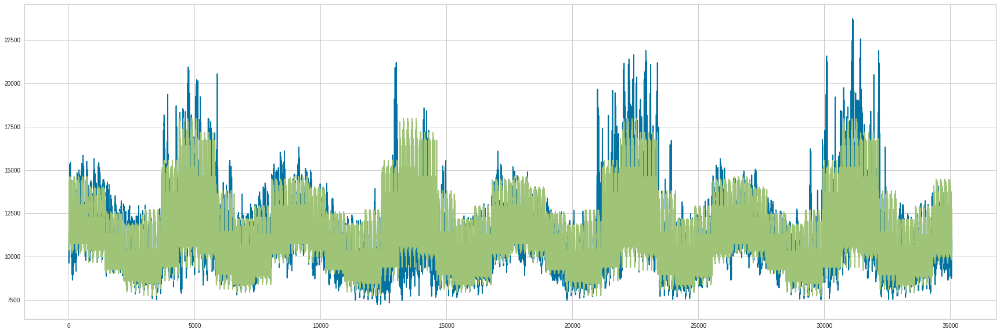

In [ ]:
# How good a model? Plot data and overlay fitted values
df['Load'].plot(figsize=(30,10))
Model.fittedvalues.plot()

In [ ]:
Model.rsquared

0.7393676385026532

In [ ]:
Model.fittedvalues.to_csv('fitted_values.csv')

In [ ]:
datelist = pd.date_range('2012-01-01', periods=366)
hours = pd.DataFrame(range(1,25)).reset_index(drop=True)
hours.columns = ['Hour']
df_dates_2012 = pd.DataFrame(datelist).reset_index(drop=True)
df_dates_2012.columns = ['Date']
df_predict = pd.merge(df_dates_2012,hours,how='cross')
# Get day of week
df_predict["day_of_week"] = df_predict["Date"].dt.dayofweek

# Get Quarter
df_predict["quarter"] = df_predict["Date"].dt.quarter

# Get Month
df_predict["month"] = df_predict["Date"].dt.month


# Get National Holidays
us_holidays = holidays.US()
df_predict["us_holidays"] = df_predict["Date"].isin(us_holidays)
df_predict["us_holidays"] = df_predict["us_holidays"].astype("int")

df_predict['Index'] = range(35065,len(df_predict)+35065)

df_predict.head()

,Date,Hour,day_of_week,quarter,month,us_holidays,Index
0,2012-01-01,1,6,1,1,0,35065
1,2012-01-01,2,6,1,1,0,35066
2,2012-01-01,3,6,1,1,0,35067
3,2012-01-01,4,6,1,1,0,35068
4,2012-01-01,5,6,1,1,0,35069


In [ ]:
Model.predict(df_predict).to_csv('predicted_values.csv')

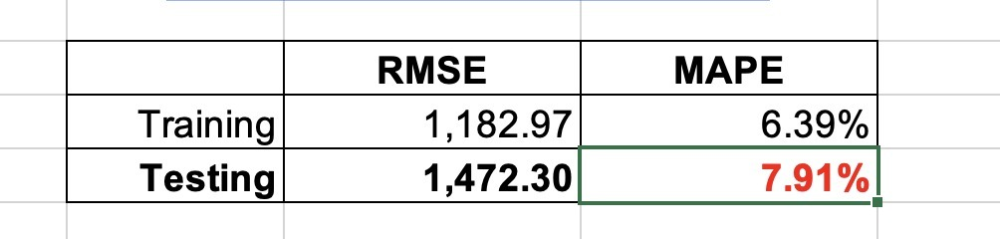

##Linear Models with 48 lags of load and temp

In [ ]:
#as we have seen in acf and pacf plots above, there is an autocorrelation between load and it's
#previous values. Let's try a model taking 48 lags (2 days worth of data)
lags_to_be_created = ['Temperature','Load']
number_of_lags=48
temp_col_names = ['temp_lag_'+str(i) for i in range(1,number_of_lags+1)]
load_col_names = ['load_lag_'+str(i) for i in range(1,number_of_lags+1)]
for i in range(1,number_of_lags+1):
  df_overall[temp_col_names[i-1]] = df_overall['Temperature'].shift(i)
  df_overall[load_col_names[i-1]] = df_overall['Load'].shift(i)

In [ ]:
df_overall.head()

,DateTime,Hour,Temperature,Load,day_of_week,quarter,month,us_holidays,Index,temp_lag_1,...,temp_lag_44,load_lag_44,temp_lag_45,load_lag_45,temp_lag_46,load_lag_46,temp_lag_47,load_lag_47,temp_lag_48,load_lag_48
0,2008-01-01 01:00:00,1,25.0,10737.0,1,1,1,0,1,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2008-01-01 02:00:00,2,24.0,10348.0,1,1,1,0,2,25.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2008-01-01 03:00:00,3,23.0,9997.0,1,1,1,0,3,24.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2008-01-01 04:00:00,4,23.0,9760.0,1,1,1,0,4,23.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2008-01-01 05:00:00,5,23.0,9624.0,1,1,1,0,5,23.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:

temp_str = ''
for i in range(0,len(temp_col_names)):
  if i!=len(temp_col_names)-1:
    temp_str = temp_str+temp_col_names[i]+'+'
  else:
    temp_str = temp_str+temp_col_names[i]
print(temp_str)

load_str = ''
for i in range(0,len(load_col_names)):
  if i!=len(load_col_names)-1:
    load_str = load_str+load_col_names[i]+'+'
  else:
    load_str = load_str+load_col_names[i]
print(load_str)

Model_with_lags_formula = 'Load ~  C(Hour) * C(day_of_week)*C(month)+Index+Temperature+'+temp_str+'+'+load_str
print(Model_with_lags_formula)

temp_lag_1+temp_lag_2+temp_lag_3+temp_lag_4+temp_lag_5+temp_lag_6+temp_lag_7+temp_lag_8+temp_lag_9+temp_lag_10+temp_lag_11+temp_lag_12+temp_lag_13+temp_lag_14+temp_lag_15+temp_lag_16+temp_lag_17+temp_lag_18+temp_lag_19+temp_lag_20+temp_lag_21+temp_lag_22+temp_lag_23+temp_lag_24+temp_lag_25+temp_lag_26+temp_lag_27+temp_lag_28+temp_lag_29+temp_lag_30+temp_lag_31+temp_lag_32+temp_lag_33+temp_lag_34+temp_lag_35+temp_lag_36+temp_lag_37+temp_lag_38+temp_lag_39+temp_lag_40+temp_lag_41+temp_lag_42+temp_lag_43+temp_lag_44+temp_lag_45+temp_lag_46+temp_lag_47+temp_lag_48
load_lag_1+load_lag_2+load_lag_3+load_lag_4+load_lag_5+load_lag_6+load_lag_7+load_lag_8+load_lag_9+load_lag_10+load_lag_11+load_lag_12+load_lag_13+load_lag_14+load_lag_15+load_lag_16+load_lag_17+load_lag_18+load_lag_19+load_lag_20+load_lag_21+load_lag_22+load_lag_23+load_lag_24+load_lag_25+load_lag_26+load_lag_27+load_lag_28+load_lag_29+load_lag_30+load_lag_31+load_lag_32+load_lag_33+load_lag_34+load_lag_35+load_lag_36+load_lag_3

In [ ]:
Model_linear_withlags = smf.ols(Model_with_lags_formula,data=df_overall[df_overall['DateTime']<'2011-01-01']).fit()

<AxesSubplot:>

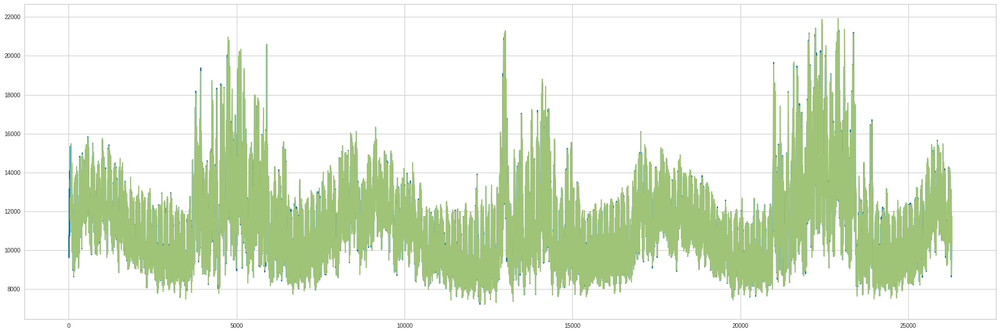

In [ ]:
df_overall[df_overall['DateTime']<'2011-01-01']['Load'].plot(figsize=(30,10))
Model_linear_withlags.fittedvalues.plot()

In [ ]:
#0.53% mape on training data
mape(df_overall[df_overall['DateTime']<'2011-01-01'].Load[number_of_lags:],Model_linear_withlags.fittedvalues)

0.53

In [ ]:
#0.6%mape on testing data. Overall a pretty good model
mape(df_overall[df_overall['DateTime'].dt.year==2011].Load[number_of_lags:],Model_linear_withlags.predict(df_overall[df_overall['DateTime'].dt.year==2011]))

0.6

<AxesSubplot:>

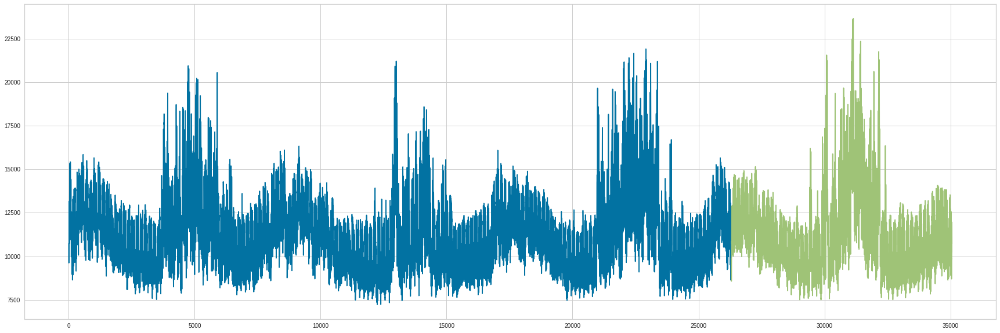

In [ ]:
df_overall[df_overall['DateTime']<'2011-01-01']['Load'].plot(figsize=(30,10))
Model_linear_withlags.predict(df_overall[df_overall['DateTime'].dt.year==2011]).plot()

In [ ]:
#let's fit the model on entire data
Model_linear_withlags_final = smf.ols(Model_with_lags_formula,data=df_overall[df_overall['DateTime']<'2012-01-01']).fit()

In [ ]:
mape(df_overall[df_overall['DateTime'].dt.year<2012].Load[number_of_lags:],Model_linear_withlags_final.fittedvalues)

0.55

In [ ]:
#df_overall[df_overall['DateTime'].dt.year==2012]

In [ ]:
h = df_overall['Load'].isna().sum()
h

8784

In [ ]:
len(df_overall)

43848

In [ ]:
#list(range(len(df_overall) - h,len(df_overall)))

In [ ]:
df_overall['linear_model_lags'] = np.nan
print(len(Model_linear_withlags_final.fittedvalues))
df_overall['linear_model_lags'][number_of_lags:len(Model_linear_withlags_final.fittedvalues)+number_of_lags]= Model_linear_withlags_final.fittedvalues

35015


In [ ]:
df_overall[df_overall.linear_model_lags.notna()].tail()

,DateTime,Hour,Temperature,Load,day_of_week,quarter,month,us_holidays,Index,temp_lag_1,...,load_lag_44,temp_lag_45,load_lag_45,temp_lag_46,load_lag_46,temp_lag_47,load_lag_47,temp_lag_48,load_lag_48,linear_model_lags
35058,2011-12-31 19:00:00,19,38.67,11907.0,5,4,12,0,35059,38.67,...,11661.0,36.67,12135.0,38.00,12393.0,37.33,12581.0,38.00,12741.0,11859.053231
35059,2011-12-31 20:00:00,20,39.33,11812.0,5,4,12,0,35060,38.67,...,10953.0,35.00,11661.0,36.67,12135.0,38.00,12393.0,37.33,12581.0,11937.279274
35060,2011-12-31 21:00:00,21,39.33,11542.0,5,4,12,0,35061,39.33,...,10131.0,32.67,10953.0,35.00,11661.0,36.67,12135.0,38.00,12393.0,11628.857205
35061,2011-12-31 22:00:00,22,39.00,11149.0,5,4,12,0,35062,39.33,...,9535.0,32.67,10131.0,32.67,10953.0,35.00,11661.0,36.67,12135.0,11260.240608
35062,2011-12-31 23:00:00,23,39.33,10855.0,5,4,12,0,35063,39.00,...,9182.0,34.33,9535.0,32.67,10131.0,32.67,10953.0,35.00,11661.0,10732.229620


In [ ]:
for i in list(range(len(df_overall) - h,len(df_overall))): # i represents row index
  for j in range(1,number_of_lags+1):
    df_overall.loc[i,'load_lag_'+str(j)] = df_overall.loc[i-j,'Load']
  df_overall.loc[i,'linear_model_lags'] = Model_linear_withlags_final.predict(df_overall.iloc[[i]]).iloc[0]
  df_overall.loc[i,'Load'] = df_overall.loc[i,'linear_model_lags']
  print(i)

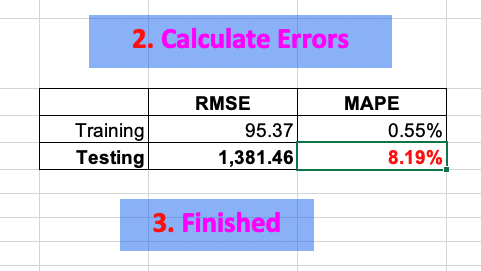

- The model performed very well on training and testing data but performed poorly on out of sample data
- Possible reason is that in testing we are using lags of actual load values where as in validation we are using forecasted lags of loads
- Error might be compounding on each other
- Overfitting can be another cause.
- Let's try to build an ensemble model XGBoost to see if it solves over fitting issue

##XGBoost with 48 lags of load and temp and interaction terms

In [ ]:
#since we observed there's some seasonality going on in the data, let's engineer below variables to take care of that
df_overall['hour_dow'] = df_overall['Hour']*df_overall['day_of_week']
df_overall['hour_month'] = df_overall['Hour']*df_overall['month']
df_overall['dow_month'] = df_overall['day_of_week']*df_overall['month']
df_overall['hour_dow_month'] = df_overall['day_of_week']*df_overall['month']*df_overall['Hour']

In [ ]:
df_overall.tail()

,DateTime,Hour,Temperature,Load,day_of_week,quarter,month,us_holidays,Index,temp_lag_1,...,temp_lag_47,load_lag_47,temp_lag_48,load_lag_48,linear_model_lags,hour_dow,hour_month,dow_month,hour_dow_month,xgb_model_lags
43843,2012-12-31 20:00:00,20,22.33,14095.487843,0,4,12,0,43844,23.33,...,21.67,12181.591100,22.33,12338.435724,14095.487843,0,240,0,0,NaN
43844,2012-12-31 21:00:00,21,20.67,13920.922145,0,4,12,0,43845,22.33,...,20.67,11990.500290,21.67,12181.591100,13920.922145,0,252,0,0,NaN
43845,2012-12-31 22:00:00,22,19.67,13628.152528,0,4,12,0,43846,20.67,...,19.00,11692.615602,20.67,11990.500290,13628.152528,0,264,0,0,NaN
43846,2012-12-31 23:00:00,23,19.33,13083.970063,0,4,12,0,43847,19.67,...,21.67,11152.690071,19.00,11692.615602,13083.970063,0,276,0,0,NaN
43847,2013-01-01 00:00:00,24,18.33,12159.822173,0,4,12,0,43848,19.33,...,16.33,10514.447773,21.67,11152.690071,12159.822173,0,288,0,0,NaN


In [ ]:
cols_to_exclude = ['DateTime','linear_model_lags','Load']
time_period_before = 2011
df_train = df_overall[df_overall['DateTime'].dt.year<time_period_before]
df_train_y = df_train['Load']
df_train.drop(columns = cols_to_exclude,axis=1,inplace=True)

X = df_train
y = df_train_y

xgb_model = XGBRegressor(objective="reg:squarederror", random_state=42)

xgb_model.fit(X, y)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.300000012, max_delta_step=0, max_depth=6,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [ ]:
mape(df_overall[df_overall['DateTime']<'2011-01-01'].Load,xgb_model.predict(X))

0.56

In [ ]:
mape(df_overall[df_overall['DateTime'].dt.year==2011].Load,xgb_model.predict(df_overall[df_overall['DateTime'].dt.year==2011].loc[:,~df_overall.columns.isin(cols_to_exclude)]))

1.08

In [ ]:
cols_to_exclude = ['DateTime','linear_model_lags','Load']
time_period_before = 2012
df_train = df_overall[df_overall['DateTime'].dt.year<time_period_before]
df_train_y = df_train['Load']
df_train.drop(columns = cols_to_exclude,axis=1,inplace=True)

X = df_train
y = df_train_y

xgb_model_final = XGBRegressor(objective="reg:squarederror", random_state=42)

xgb_model_final.fit(X, y)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.300000012, max_delta_step=0, max_depth=6,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [ ]:
mape(df_overall[df_overall['DateTime'].dt.year<2012].Load,xgb_model_final.predict(X))

0.57

In [ ]:
df_overall['xgb_model_lags'] = np.nan
print(len(xgb_model_final.predict(X)))
df_overall['xgb_model_lags'][0:len(xgb_model_final.predict(X))]= xgb_model_final.predict(X)

35063


In [ ]:
for i in list(range(len(df_overall) - h,len(df_overall))): # i represents row index
  for j in range(1,number_of_lags+1):
    df_overall.loc[i,'load_lag_'+str(j)] = df_overall.loc[i-j,'Load']
  df_overall.loc[i,'xgb_model_lags'] = Model_linear_withlags_final.predict(df_overall.iloc[[i]]).iloc[0]
  df_overall.loc[i,'Load'] = df_overall.loc[i,'xgb_model_lags']
  print(i)

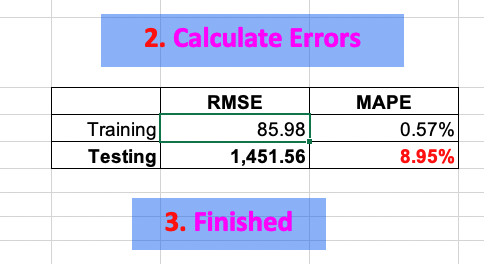

In [ ]:
df_overall.to_csv('df_overall_xgb_lags.csv')

-Ensemble model did not show any improvement
-Let's try a model without any lag variables to eliminate error compounding effect

##XGBoost without any lags and just with interaction terms

In [ ]:
load_lag_columns = df_overall.columns[df_overall.columns.str.contains('load_lag')].tolist()
temp_lag_columns = df_overall.columns[df_overall.columns.str.contains('temp_lag')].tolist()
time_period_before = 2011
cols_to_exclude = ['DateTime','linear_model_lags','Load','xgb_model_lags']+load_lag_columns+temp_lag_columns
#print(cols_to_exclude)
df_train = df_overall[df_overall['DateTime'].dt.year<time_period_before]
df_train_y = df_train['Load']
df_train.drop(columns = cols_to_exclude,axis=1,inplace=True)

X = df_train
y = df_train_y

xgb_model = XGBRegressor(objective="reg:squarederror", random_state=42)

xgb_model.fit(X, y)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.300000012, max_delta_step=0, max_depth=6,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [ ]:
mape(df_overall[df_overall['DateTime']<'2011-01-01'].Load,xgb_model.predict(X))

1.5

In [ ]:
mape(df_overall[df_overall['DateTime'].dt.year==2011].Load,xgb_model.predict(df_overall[df_overall['DateTime'].dt.year==2011].loc[:,~df_overall.columns.isin(cols_to_exclude)]))

5.09

In [ ]:
params = { 'max_depth': [3,6,10],
           'learning_rate': [0.01, 0.05, 0.1],
           'n_estimators': [100, 500, 1000],
           'colsample_bytree': [0.3, 0.7]}
xgbr = XGBRegressor(seed = 20)
clf = GridSearchCV(estimator=xgbr, 
                   param_grid=params,
                   scoring='neg_mean_absolute_percentage_error', 
                   verbose=1)
clf.fit(X, y)
print("Best parameters:", clf.best_params_)
print("Lowest MAPE: ", (-clf.best_score_)**(1/2.0))

Fitting 5 folds for each of 54 candidates, totalling 270 fits
Best parameters: {'colsample_bytree': 0.3, 'learning_rate': 0.05, 'max_depth': 3, 'n_estimators': 500}
Lowest RMSE:  0.21682296096204323


In [ ]:
mape(df_overall[df_overall['DateTime']<'2011-01-01'].Load,clf.predict(X))

In [ ]:
mape(df_overall[df_overall['DateTime'].dt.year==2011].Load,clf.predict(df_overall[df_overall['DateTime'].dt.year==2011].loc[:,~df_overall.columns.isin(cols_to_exclude)]))

3.42

In [ ]:
new_tuned_model = clf.best_estimator_
print(new_tuned_model)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=0.3, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.05, max_delta_step=0, max_depth=3,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=500, n_jobs=0, num_parallel_tree=1, random_state=20,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=20,
             subsample=1, tree_method='exact', validate_parameters=1,
             verbosity=None)


In [ ]:
time_period_before = 2012
df_train = df_overall[df_overall['DateTime'].dt.year<time_period_before]
df_train_y = df_train['Load']
df_train.drop(columns = cols_to_exclude,axis=1,inplace=True)

X = df_train
y = df_train_y


new_tuned_model.fit(X, y)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=0.3, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.05, max_delta_step=0, max_depth=3,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=500, n_jobs=0, num_parallel_tree=1, random_state=20,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=20,
             subsample=1, tree_method='exact', validate_parameters=1,
             verbosity=None)

In [ ]:
mape(df_overall[df_overall['DateTime'].dt.year<2012].Load,new_tuned_model.predict(X))

3.53

In [ ]:
time_period_before = 2012
df_predict = df_overall[df_overall['DateTime'].dt.year==time_period_before]
df_predict.drop(columns = cols_to_exclude,axis=1,inplace=True)

In [ ]:
xgb_predict_tuned = pd.DataFrame(new_tuned_model.predict(df_predict))

In [ ]:
xgb_predict.to_csv('xgb_predict_tuned.csv')

In [ ]:
xgb_train_tuned = pd.DataFrame(new_tuned_model.predict(X))
xgb_train_tuned.to_csv('xgb_train_tuned.csv')

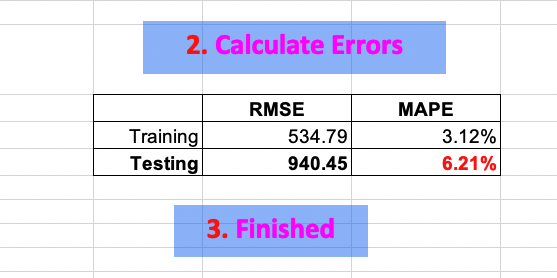

In [ ]:
adf_overall['xgb_model_lags'] = np.nan
print(len(xgb_model_final.predict(X)))
df_overall['linear_model_lags'][0:len(xgb_model_final.predict(X))]= xgb_model_final.predict(X)

- Looks like this model is much better than above models

## Pycaret

In [3]:
# Read file
df = pd.read_csv('https://raw.githubusercontent.com/robertasgabrys/Forecasting/main/Competition_Data.csv')

# Convert date dtype to datetime
df["Date"] = pd.to_datetime(df["Date"], format='%m/%d/%Y')

# Convert datetime dtype to datetime
df["DateTime"] = pd.to_datetime(df["DateTime"], format = "%m/%d/%Y %H:%M")

# Get day of week
df["day_of_week"] = df["Date"].dt.dayofweek

# Get Quarter
df["quarter"] = df["Date"].dt.quarter

# Get Month
df["month"] = df["Date"].dt.month


# Get National Holidays
us_holidays = holidays.US()
df["us_holidays"] = df["Date"].isin(us_holidays)
df["us_holidays"] = df["us_holidays"].astype("int")

# Get year
df["year"] = df["Date"].dt.year

# Get day of year
df["day_of_year"] = df["Date"].dt.dayofyear

# Get week of year
df["week_of_year"] = df["Date"].dt.weekofyear

# Drop date
df = df.drop(["Date"], axis = 1)

# review
df.head()

#create index for trend
df['Index'] = range(1,len(df)+1)



In [4]:
# Prepare data for further analysis: seperate validation data
df_overall = df.copy()
df_validation = df[df["Load"].isna()].copy()
df = df.dropna()

In [5]:
# Get training data for modeling
df_train = df.set_index("DateTime")
df_train.index = df_train.index.to_period("H") #required for removing pycaret bugs

### Get training and testing data for pycaret

In [6]:
# Find Forecast Horizon
df_validation.shape

(8784, 12)

In [7]:
# Get training data for modeling
df_train = df.set_index("DateTime")
df_train.index = df_train.index.to_period("H") #required for removing pycaret bugs


### Without Exogenous Variables

#### Setup and visualizations

In [ ]:
# set up pycaret
s = setup(data = df_train['Load'], 
                   transform_target = 'box-cox',seasonal_period = ['W','M','H'],
      fold = 2,fh = 8784, session_id = 123)

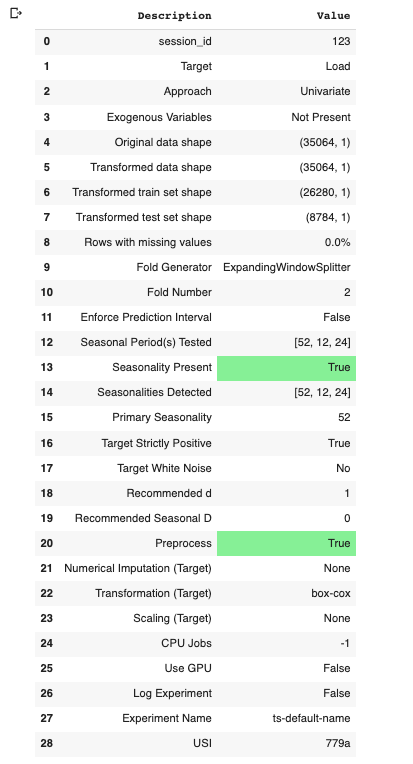

In [ ]:
# Check some statistics for our data set
check_stats()

# Ljung-Box test is the test to see if data is white noise (use to assess model's adequacy)
# Ho: correlation(y(t),y(t-1))=correlation(y(t),y(t-2))=...=correlation(y(t),y(t-k))=0
# Ho in words: data are uncorrelated/"independent" = there are no systematically changing paterns, i.e. 
# there are no predictable patterns, i.e. data is white noise and we do not need to build a model
# because theer is nothing to be modeled. 

# Ha: there is exist at least one k for which correlation(y(t),y(t-k))<>0
# Ha in words: there is dependence (systematically changing patterns, autocorrelation)
# that needs to be modeled using a model

# How to assess whether a model is good/adequate?
# A model is adequate if residuals contain no systematically cahanging patterns and 
# and residuals are white noise (we fail to reject Ljung-Box test Ho). 


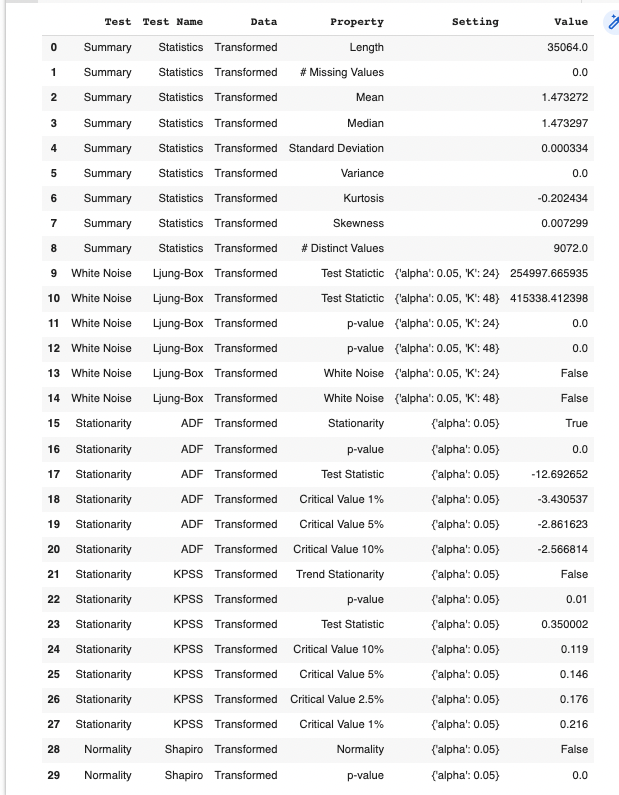

In [ ]:
# Visualize Load
plot_model()

In [ ]:
# Visualize acf for Load
plot_model(plot='acf')

In [ ]:
# Visualize pacf for Load
plot_model(plot='pacf')

In [ ]:
# Check diagnostic visualization in pycaret
plot_model(plot='diagnostics')

#### Model

In [ ]:
# Train classical time series and machine learning models
# using cross validation. In our example we use 2-fold CV
# The table contains cross validated errors = (fold 1 testing error + fold 2 testing error) / 2
# M = compare_models(sort='mape')
M = compare_models()

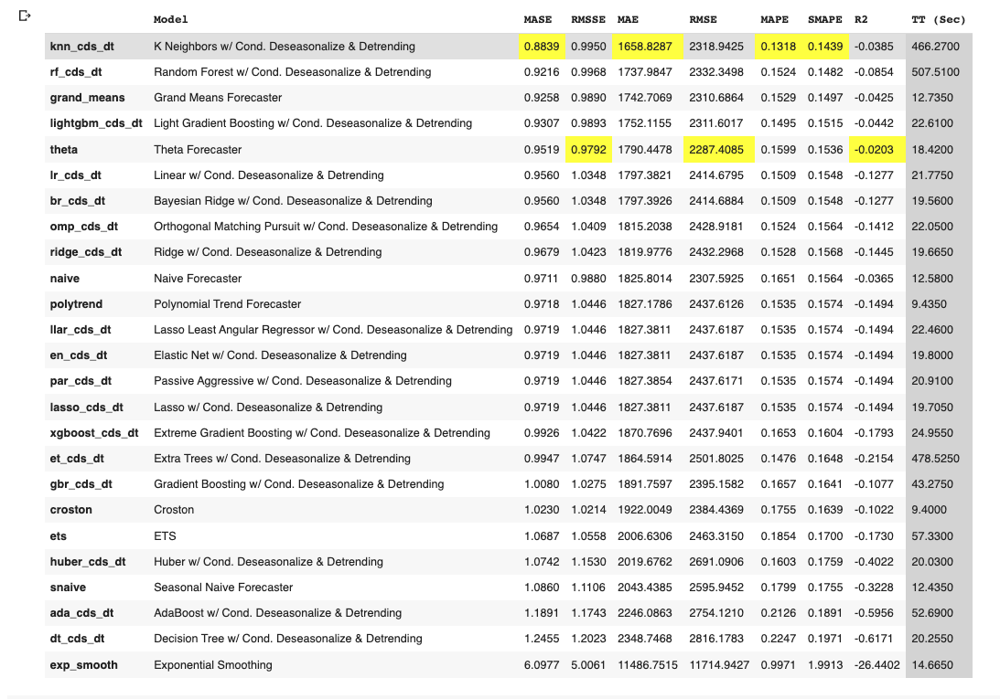

In [ ]:
# view best model parameters
M.get_params()

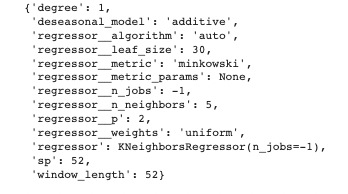

In [ ]:
# Export this python object that has all models: useful for insample predictions
with open('M', 'wb') as files:
    pickle.dump(M, files)


In [ ]:
# Make insample predictions

predicted = predict_model(M, X = df_train, fh = list(range(0, -(len(df_train) - 8784), -1)))

In [ ]:
# Export insample predicted values
predicted.to_csv('predict_non_exo_insample.csv')


In [ ]:
# finalize model
knn_final = finalize_model(M)


In [ ]:
# save finalized model object
with open('knn_full', 'wb') as files:
    pickle.dump(knn_final, files)

In [ ]:
# create dataframe for prediction
df_predict = pd.date_range(start="2012-01-01",end="2013-01-01",freq='H')
df_predict = pd.DataFrame(df_predict)
df_predict.columns = ['DateTime']
df_predict = df_predict.set_index("DateTime")
df_predict.index = df_predict.index.to_period("H")
df_predict =df_predict[:-1] 

In [ ]:
# Predict future values: forecast horizon values
predict = predict_model(knn_final,X=df_predict,fh=8784)
predict.to_csv('predict_non_exo_knn_full.csv')

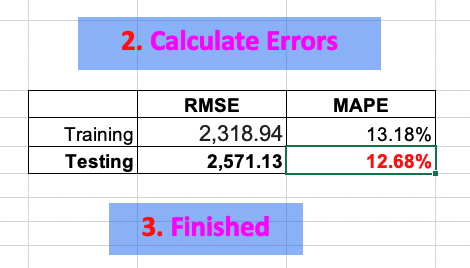

In [ ]:
# # Tune Model and make predictions again: not the best model, so didn't tune
# M_tuned = tune_model(M)

### With Exogenous Variables: BEST MODEL- LIGHTGBM

#### Setup and visualization

In [ ]:
s = setup(data = df_train, target = 'Load',
                   transform_target = 'box-cox',seasonal_period = ['W','M','H'],
      fold = 2,fh = 8784, session_id = 123) 

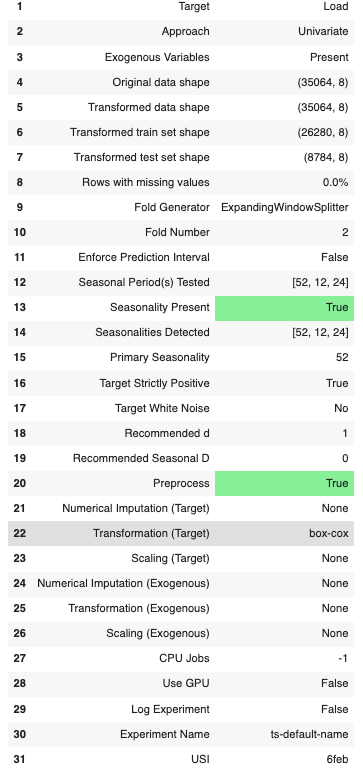

In [ ]:
# Check some statistics for our data set
check_stats()

# Ljung-Box test is the test to see if data is white noise (use to assess model's adequacy)
# Ho: correlation(y(t),y(t-1))=correlation(y(t),y(t-2))=...=correlation(y(t),y(t-k))=0
# Ho in words: data are uncorrelated/"independent" = there are no systematically changing paterns, i.e. 
# there are no predictable patterns, i.e. data is white noise and we do not need to build a model
# because theer is nothing to be modeled. 

# Ha: there is exist at least one k for which correlation(y(t),y(t-k))<>0
# Ha in words: there is dependence (systematically changing patterns, autocorrelation)
# that needs to be modeled using a model

# How to assess whether a model is good/adequate?
# A model is adequate if residuals contain no systematically cahanging patterns and 
# and residuals are white noise (we fail to reject Ljung-Box test Ho). 


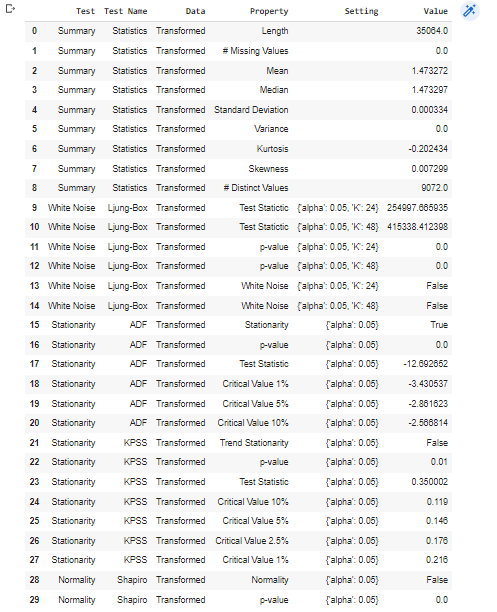

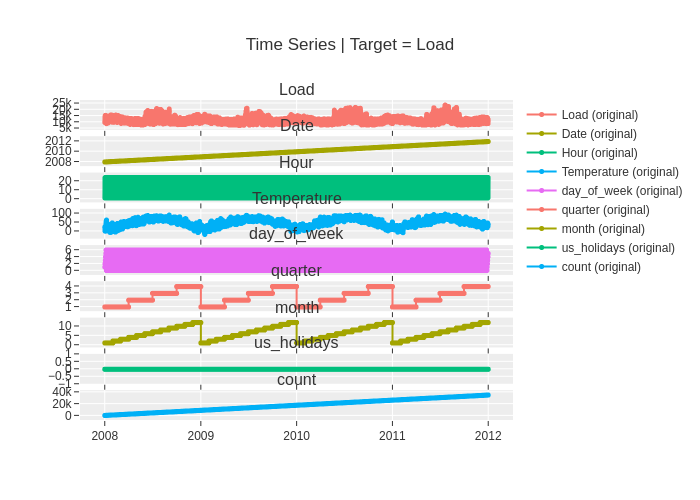

In [ ]:
# Get plots for all variables in our dataset
plot_model()

#### Model

##### Gradient Boosting: best model default

In [ ]:
%%time

# Train classical time series and machine learning models
# using cross validation. In our example we use 2-fold CV
# The table contains cross validated errors = (fold 1 testing error + fold 2 testing error) / 2
# M = compare_models(sort='mape')
best_exo = compare_models(include = ["lr_cds_dt", "snaive", "xgboost_cds_dt", "gbr_cds_dt", "lightgbm_cds_dt", "ada_cds_dt", "et_cds_dt"])

,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2,TT (Sec)
gbr_cds_dt,Gradient Boosting w/ Cond. Deseasonalize & Detrending,0.3198,0.3404,601.3918,794.8769,0.0505,0.0512,0.8771,142.5750
lightgbm_cds_dt,Light Gradient Boosting w/ Cond. Deseasonalize & Detrending,0.3218,0.3488,603.0135,812.4741,0.0500,0.0515,0.8723,36.0800
xgboost_cds_dt,Extreme Gradient Boosting w/ Cond. Deseasonalize & Detrending,0.3256,0.3454,611.2299,805.3006,0.0511,0.0519,0.8748,53.9950
et_cds_dt,Extra Trees w/ Cond. Deseasonalize & Detrending,0.3524,0.4148,661.5700,966.8899,0.0539,0.0551,0.8195,626.7850
ada_cds_dt,AdaBoost w/ Cond. Deseasonalize & Detrending,0.8401,0.8754,1583.8334,2047.8389,0.1413,0.1353,0.1669,115.2950
snaive,Seasonal Naive Forecaster,1.0860,1.1106,2043.4385,2595.9452,0.1799,0.1755,-0.3228,17.8250
lr_cds_dt,Linear w/ Cond. Deseasonalize & Detrending,2.1960,1.9721,4184.2873,4664.7632,0.3578,0.4926,-5.4331,33.4150


Processing:   0%|          | 0/33 [00:00<?, ?it/s]

CPU times: user 5min 49s, sys: 3.06 s, total: 5min 52s
Wall time: 39min 38s


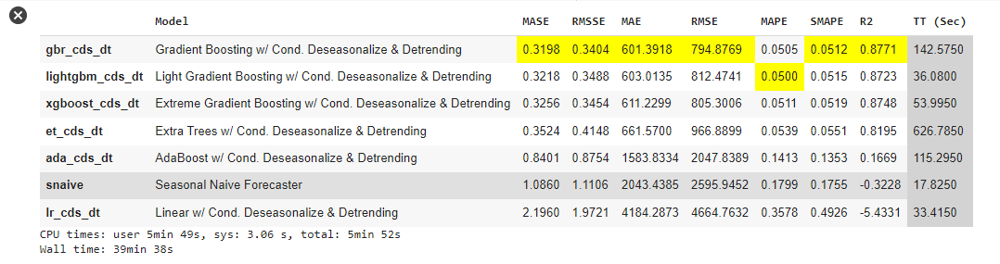

In [ ]:
# Export this python object that includes all the models trained: Default model is gradient boosting
# This is important for making insample predictions

with open('best_exo', 'wb') as files:
    pickle.dump(best_exo, files)

In [ ]:
best_exo.get_params()

{'degree': 1,
 'deseasonal_model': 'additive',
 'regressor__alpha': 0.9,
 'regressor__ccp_alpha': 0.0,
 'regressor__criterion': 'friedman_mse',
 'regressor__init': None,
 'regressor__learning_rate': 0.1,
 'regressor__loss': 'squared_error',
 'regressor__max_depth': 3,
 'regressor__max_features': None,
 'regressor__max_leaf_nodes': None,
 'regressor__min_impurity_decrease': 0.0,
 'regressor__min_samples_leaf': 1,
 'regressor__min_samples_split': 2,
 'regressor__min_weight_fraction_leaf': 0.0,
 'regressor__n_estimators': 100,
 'regressor__n_iter_no_change': None,
 'regressor__random_state': 123,
 'regressor__subsample': 1.0,
 'regressor__tol': 0.0001,
 'regressor__validation_fraction': 0.1,
 'regressor__verbose': 0,
 'regressor__warm_start': False,
 'regressor': GradientBoostingRegressor(random_state=123),
 'sp': 52,
 'window_length': 52}

In [ ]:
# Overlay forecast values:
plot_model(best_exo, plot = 'forecast', data_kwargs = {'fh' : 8784})

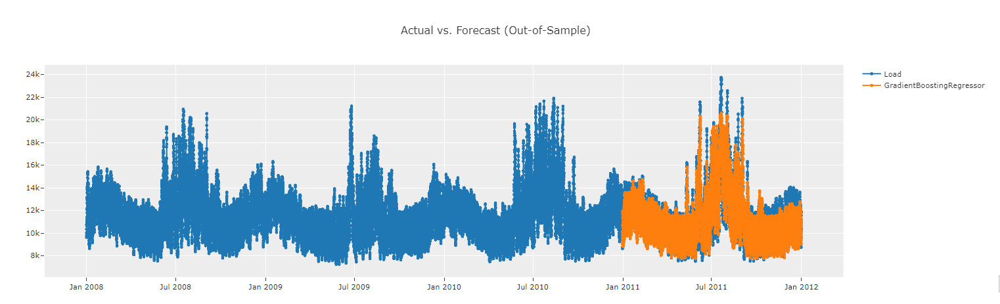

In [ ]:
# We now finalize our model to make predictions for the future

# Finalize model
gbr_exo_final = finalize_model(best_exo)

In [ ]:
# Pickle dump finalized model
with open('gbr_exo_final', 'wb') as files:
    pickle.dump(gbr_exo_final, files)

In [ ]:
# Create dataframe for prediction

df_predict = df_validation.set_index("DateTime")
df_predict.index = df_predict.index.to_period("H")
df_predict.drop(columns = 'Load',axis=1,inplace=True)

df_predict.head()

,Hour,Temperature,day_of_week,quarter,month,us_holidays,year,day_of_year,week_of_year,Index
DateTime,,,,,,,,,,
2012-01-01 01:00,1,39.33,6,1,1,0,2012,1,52,35065
2012-01-01 02:00,2,40.33,6,1,1,0,2012,1,52,35066
2012-01-01 03:00,3,39.67,6,1,1,0,2012,1,52,35067
2012-01-01 04:00,4,42.33,6,1,1,0,2012,1,52,35068
2012-01-01 05:00,5,43.00,6,1,1,0,2012,1,52,35069


In [ ]:
# Make prediction for future forecast horizon
predict_exo = predict_model(gbr_exo_final,X=df_predict,fh=8784)

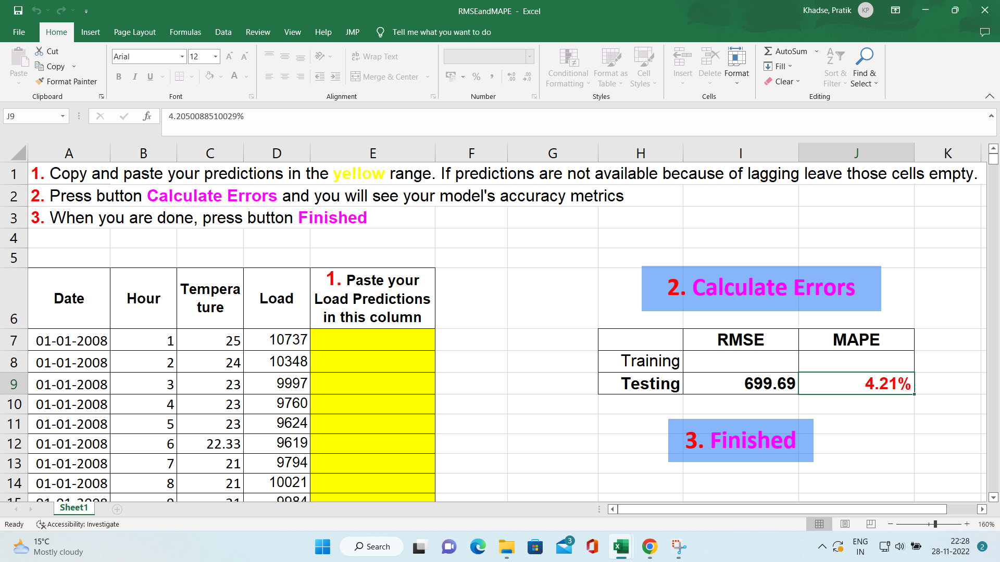

In [ ]:
# Export prediction
predict_exo.to_csv('predict_exo_gbr.csv')

##### LightGBM

In [ ]:
# Create lgbm model: since this was the best one

lgbm_exo = create_model("lightgbm_cds_dt")

,cutoff,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2
0,2008-12-29 00:00,0.2138,0.2529,410.2058,604.3192,0.0359,0.0359,0.9103
1,2009-12-30 00:00,0.4297,0.4447,795.8212,1020.6291,0.0642,0.0670,0.8344
Mean,NaT,0.3218,0.3488,603.0135,812.4741,0.0500,0.0515,0.8723
SD,NaT,0.1080,0.0959,192.8077,208.1549,0.0141,0.0156,0.0380


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

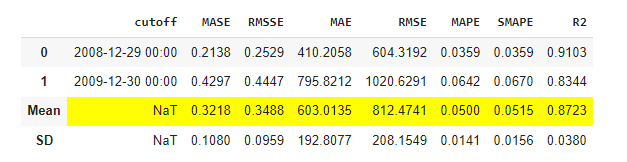

In [ ]:
# Export this python object that includes lgbm
with open('lgbm_exo', 'wb') as files:
    pickle.dump(lgbm_exo, files)

In [ ]:
# get best params
lgbm_exo.get_params()

{'degree': 1,
 'deseasonal_model': 'additive',
 'regressor__boosting_type': 'gbdt',
 'regressor__class_weight': None,
 'regressor__colsample_bytree': 1.0,
 'regressor__importance_type': 'split',
 'regressor__learning_rate': 0.1,
 'regressor__max_depth': -1,
 'regressor__min_child_samples': 20,
 'regressor__min_child_weight': 0.001,
 'regressor__min_split_gain': 0.0,
 'regressor__n_estimators': 100,
 'regressor__n_jobs': -1,
 'regressor__num_leaves': 31,
 'regressor__objective': None,
 'regressor__random_state': 123,
 'regressor__reg_alpha': 0.0,
 'regressor__reg_lambda': 0.0,
 'regressor__silent': 'warn',
 'regressor__subsample': 1.0,
 'regressor__subsample_for_bin': 200000,
 'regressor__subsample_freq': 0,
 'regressor': LGBMRegressor(random_state=123),
 'sp': 52,
 'window_length': 52}

In [ ]:
# Overlay forecast values: 
plot_model(lgbm_exo, plot = 'forecast', data_kwargs = {'fh' : 8784})

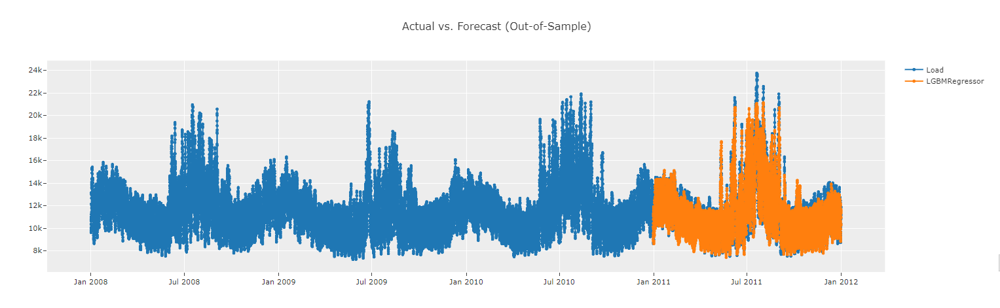

In [ ]:
# Finalize model
lgbm_exo_final = finalize_model(lgbm_exo)

In [ ]:
# Pickle dump finalized model
with open('lgbm_exo_final', 'wb') as files:
    pickle.dump(lgbm_exo_final, files)

In [ ]:
# Create dataframe for prediction

df_predict = df_validation.set_index("DateTime")
df_predict.index = df_predict.index.to_period("H")
df_predict.drop(columns = 'Load',axis=1,inplace=True)

df_predict.head()

,Hour,Temperature,day_of_week,quarter,month,us_holidays,year,day_of_year,week_of_year,Index
DateTime,,,,,,,,,,
2012-01-01 01:00,1,39.33,6,1,1,0,2012,1,52,35065
2012-01-01 02:00,2,40.33,6,1,1,0,2012,1,52,35066
2012-01-01 03:00,3,39.67,6,1,1,0,2012,1,52,35067
2012-01-01 04:00,4,42.33,6,1,1,0,2012,1,52,35068
2012-01-01 05:00,5,43.00,6,1,1,0,2012,1,52,35069


In [ ]:
# Make prediction for future forecast horizon
predict_exo = predict_model(lgbm_exo_final,X=df_predict,fh=8784)

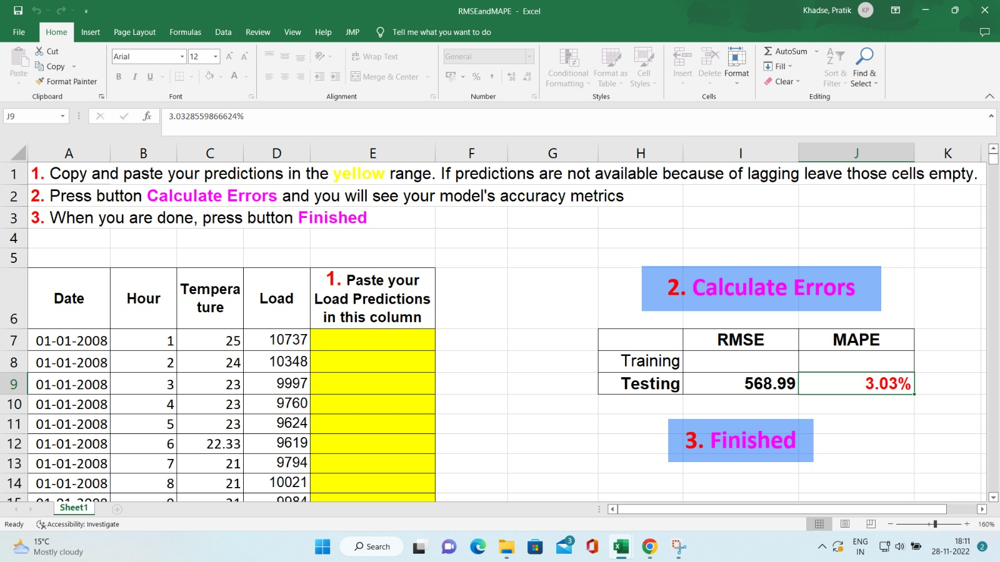

In [ ]:
# Export prediction
predict_exo.to_csv('lgbm_exo_final.csv')

##### XGBoost

In [ ]:
# Create xgb model: since this was the best one

xgb_exo = create_model("xgboost_cds_dt")

,cutoff,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2
0,2008-12-29 00:00,0.2501,0.2669,479.8652,637.8714,0.0433,0.0426,0.9000
1,2009-12-30 00:00,0.4010,0.4238,742.5946,972.7299,0.0589,0.0613,0.8495
Mean,NaT,0.3256,0.3454,611.2299,805.3006,0.0511,0.0519,0.8748
SD,NaT,0.0754,0.0785,131.3647,167.4292,0.0078,0.0094,0.0253


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

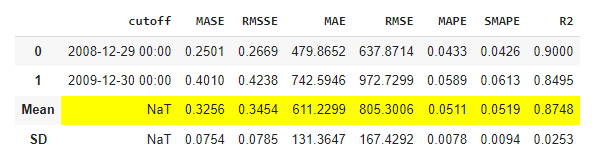

In [ ]:
# Export this python object that includes xgboost
with open('xgb_exo', 'wb') as files:
    pickle.dump(xgb_exo, files)

In [ ]:
# get best params
xgb_exo.get_params()

{'degree': 1,
 'deseasonal_model': 'additive',
 'regressor__objective': 'reg:squarederror',
 'regressor__base_score': None,
 'regressor__booster': 'gbtree',
 'regressor__colsample_bylevel': None,
 'regressor__colsample_bynode': None,
 'regressor__colsample_bytree': None,
 'regressor__gamma': None,
 'regressor__gpu_id': None,
 'regressor__importance_type': 'gain',
 'regressor__interaction_constraints': None,
 'regressor__learning_rate': None,
 'regressor__max_delta_step': None,
 'regressor__max_depth': None,
 'regressor__min_child_weight': None,
 'regressor__missing': nan,
 'regressor__monotone_constraints': None,
 'regressor__n_estimators': 100,
 'regressor__n_jobs': -1,
 'regressor__num_parallel_tree': None,
 'regressor__random_state': 123,
 'regressor__reg_alpha': None,
 'regressor__reg_lambda': None,
 'regressor__scale_pos_weight': None,
 'regressor__subsample': None,
 'regressor__tree_method': 'auto',
 'regressor__validate_parameters': None,
 'regressor__verbosity': 0,
 'regressor'

In [ ]:
# Overlay forecast values: TO DO: shift
plot_model(xgb_exo, plot = 'forecast', data_kwargs = {'fh' : 8784})

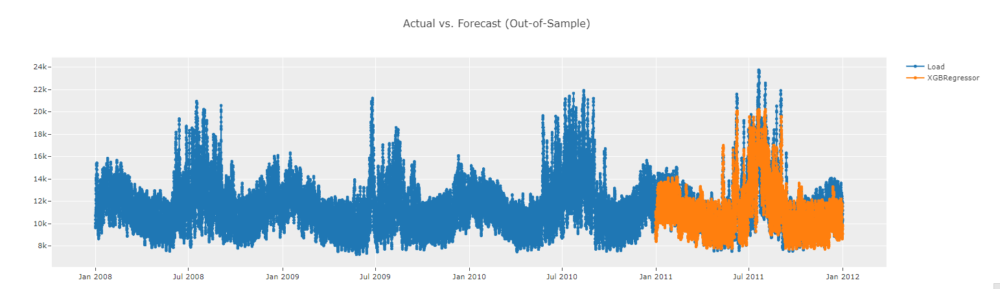

In [ ]:
# Finalize model
xgb_exo_final = finalize_model(xgb_exo)

In [ ]:
# Pickle dump finalized model
with open('xgb_exo_final', 'wb') as files:
    pickle.dump(xgb_exo_final, files)

In [ ]:
# Create dataframe for prediction

df_predict = df_validation.set_index("DateTime")
df_predict.index = df_predict.index.to_period("H")
df_predict.drop(columns = 'Load',axis=1,inplace=True)

df_predict.head()

,Hour,Temperature,day_of_week,quarter,month,us_holidays,year,day_of_year,week_of_year,Index
DateTime,,,,,,,,,,
2012-01-01 01:00,1,39.33,6,1,1,0,2012,1,52,35065
2012-01-01 02:00,2,40.33,6,1,1,0,2012,1,52,35066
2012-01-01 03:00,3,39.67,6,1,1,0,2012,1,52,35067
2012-01-01 04:00,4,42.33,6,1,1,0,2012,1,52,35068
2012-01-01 05:00,5,43.00,6,1,1,0,2012,1,52,35069


In [ ]:
# Make prediction for future forecast horizon
predict_exo = predict_model(xgb_exo_final,X=df_predict,fh=8784)

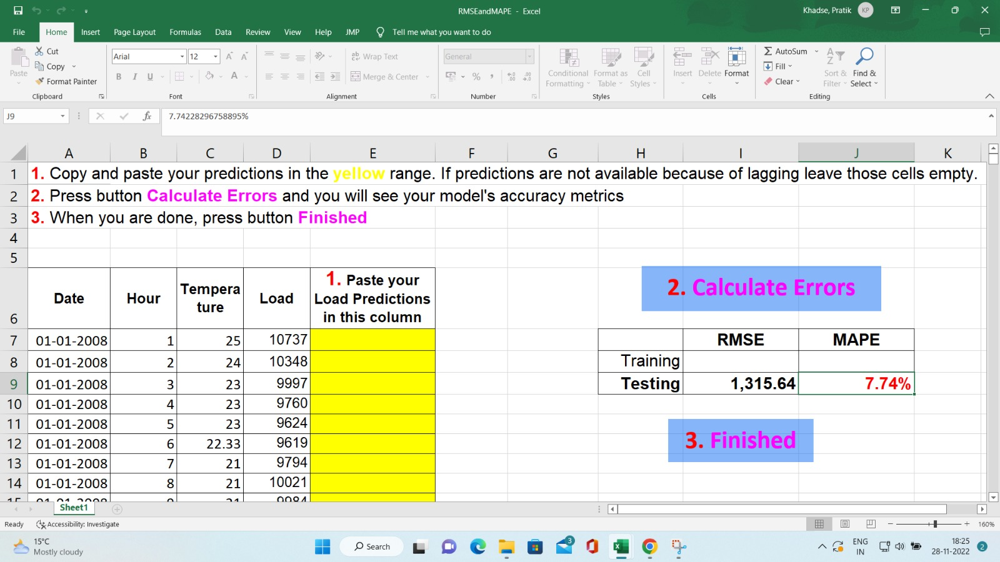

In [ ]:
# Export prediction
predict_exo.to_csv('xgb_exo_final.csv')

##### Blend models

In [ ]:
blended = blend_models([lgbm_exo, best_exo], optimize="MAPE")

,cutoff,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2
0,2008-12-29 00:00,0.2243,0.2466,430.4433,589.4300,0.0380,0.0378,0.9147
1,2009-12-30 00:00,0.3851,0.4036,713.2146,926.3254,0.0571,0.0592,0.8636
Mean,NaT,0.3047,0.3251,571.8289,757.8777,0.0475,0.0485,0.8891
SD,NaT,0.0804,0.0785,141.3857,168.4477,0.0095,0.0107,0.0255


Processing:   0%|          | 0/6 [00:00<?, ?it/s]

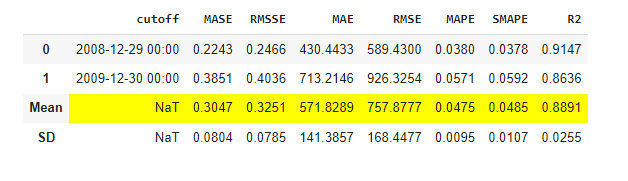

In [ ]:
# Export this python object that includes blended
with open('blended_exo', 'wb') as files:
    pickle.dump(blended, files)

In [ ]:
# get best params
blended.get_params()

{'forecasters': [('LGBMRegressor',
   BaseCdsDtForecaster(regressor=LGBMRegressor(random_state=123), sp=52,
                       window_length=52)),
  ('GradientBoostingRegressor',
   BaseCdsDtForecaster(regressor=GradientBoostingRegressor(random_state=123),
                       sp=52, window_length=52))],
 'method': 'mean',
 'n_jobs': -1,
 'weights': None,
 'LGBMRegressor': BaseCdsDtForecaster(regressor=LGBMRegressor(random_state=123), sp=52,
                     window_length=52),
 'GradientBoostingRegressor': BaseCdsDtForecaster(regressor=GradientBoostingRegressor(random_state=123),
                     sp=52, window_length=52),
 'LGBMRegressor__degree': 1,
 'LGBMRegressor__deseasonal_model': 'additive',
 'LGBMRegressor__regressor__boosting_type': 'gbdt',
 'LGBMRegressor__regressor__class_weight': None,
 'LGBMRegressor__regressor__colsample_bytree': 1.0,
 'LGBMRegressor__regressor__importance_type': 'split',
 'LGBMRegressor__regressor__learning_rate': 0.1,
 'LGBMRegressor__regre

In [ ]:
# Overlay forecast values: TO DO: shift
plot_model(blended, plot = 'forecast', data_kwargs = {'fh' : 8784})

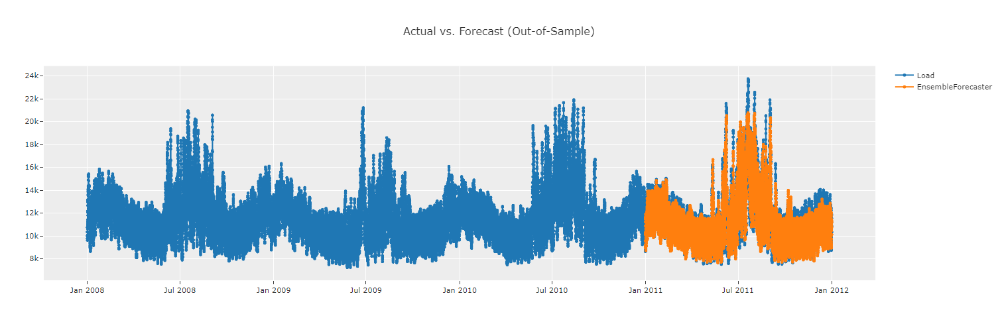

In [ ]:
# Finalize model
blended_exo_final = finalize_model(blended)

In [ ]:
# Pickle dump finalized model
with open('blended_exo_final', 'wb') as files:
    pickle.dump(blended_exo_final, files)

In [ ]:
# Create dataframe for prediction

df_predict = df_validation.set_index("DateTime")
df_predict.index = df_predict.index.to_period("H")
df_predict.drop(columns = 'Load',axis=1,inplace=True)

df_predict.head()

,Hour,Temperature,day_of_week,quarter,month,us_holidays,year,day_of_year,week_of_year,Index
DateTime,,,,,,,,,,
2012-01-01 01:00,1,39.33,6,1,1,0,2012,1,52,35065
2012-01-01 02:00,2,40.33,6,1,1,0,2012,1,52,35066
2012-01-01 03:00,3,39.67,6,1,1,0,2012,1,52,35067
2012-01-01 04:00,4,42.33,6,1,1,0,2012,1,52,35068
2012-01-01 05:00,5,43.00,6,1,1,0,2012,1,52,35069


In [ ]:
# Make prediction for future forecast horizon
predict_exo = predict_model(blended_exo_final,X=df_predict,fh=8784)

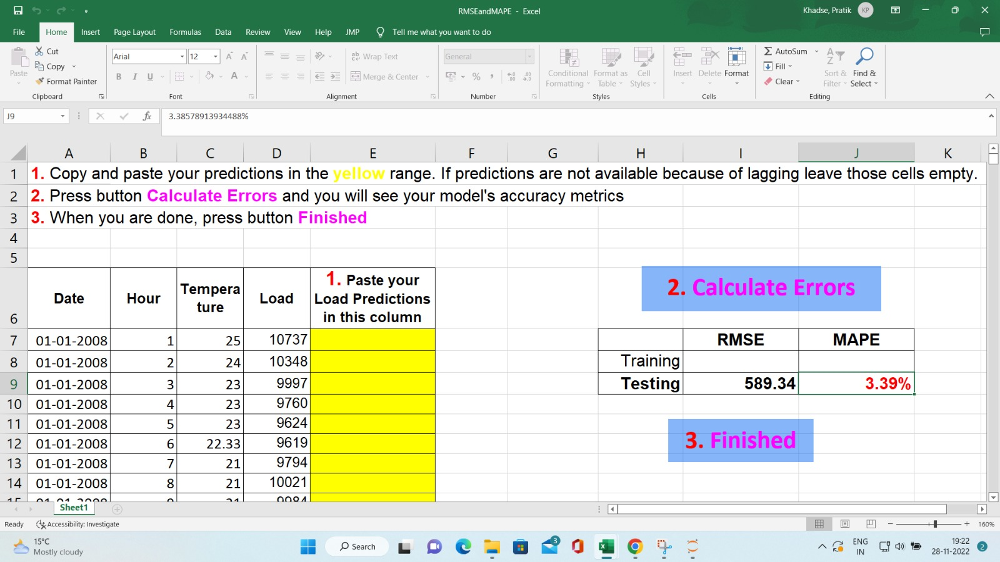

In [ ]:
# Export prediction
predict_exo.to_csv('blended_exo_final.csv')

##### Tune Best Model: LightGBM

In [ ]:
M_tuned = tune_model(lgbm_exo, optimize = "MAPE", n_iter = 3)

,cutoff,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2
0,2008-12-29 00:00,2.9032,2.7469,5570.3214,6564.7112,0.4876,0.7360,-9.5865
1,2009-12-30 00:00,1.2521,1.2479,2318.6236,2864.1521,0.2045,0.1848,-0.3044
Mean,NaT,2.0776,1.9974,3944.4725,4714.4316,0.3461,0.4604,-4.9455
SD,NaT,0.8256,0.7495,1625.8489,1850.2795,0.1415,0.2756,4.6410


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 2 folds for each of 3 candidates, totalling 6 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of   6 | elapsed:  5.4min finished


In [ ]:
# Pickle dump finalized model
with open('lgbm_exo_tuned', 'wb') as files:
    pickle.dump(M_tuned, files)

In [ ]:
# finalize model
lgbm_final_exo_tuned = finalize_model(M_tuned)

In [ ]:
# Pickle dump finalized model
with open('lgbm_final_exo_tuned', 'wb') as files:
    pickle.dump(lgbm_final_exo_tuned, files)

In [ ]:
# Create dataframe for prediction

df_predict = df_validation.set_index("DateTime")
df_predict.index = df_predict.index.to_period("H")
df_predict.drop(columns = 'Load',axis=1,inplace=True)

df_predict.head()

,Hour,Temperature,day_of_week,quarter,month,us_holidays,year,day_of_year,week_of_year,Index
DateTime,,,,,,,,,,
2012-01-01 01:00,1,39.33,6,1,1,0,2012,1,52,35065
2012-01-01 02:00,2,40.33,6,1,1,0,2012,1,52,35066
2012-01-01 03:00,3,39.67,6,1,1,0,2012,1,52,35067
2012-01-01 04:00,4,42.33,6,1,1,0,2012,1,52,35068
2012-01-01 05:00,5,43.00,6,1,1,0,2012,1,52,35069


In [ ]:
# Make prediction for future forecast horizon
predict_exo = predict_model(lgbm_final_exo_tuned,X=df_predict,fh=8784)

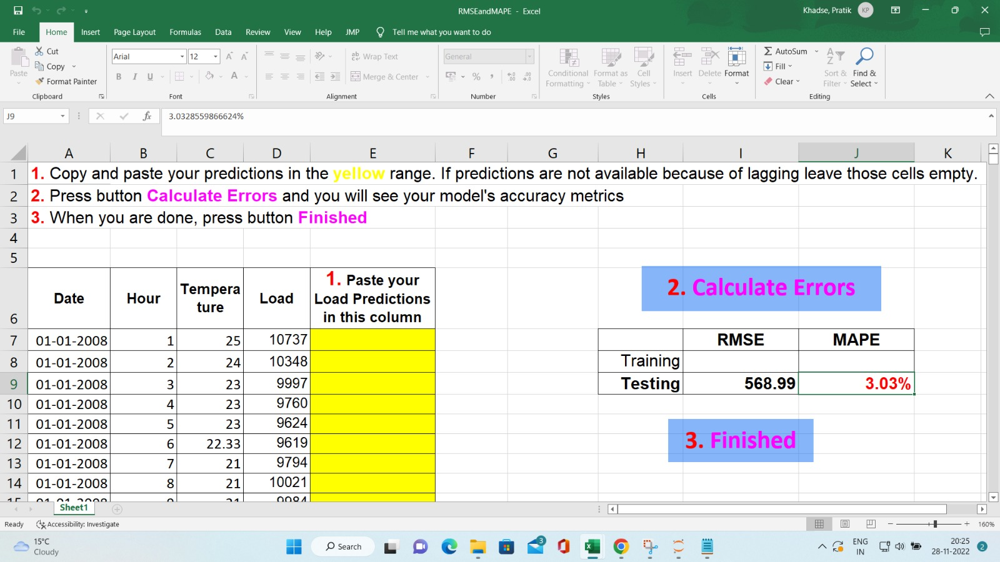

In [ ]:
# Export prediction
predict_exo.to_csv('lgbm_final_exo_tuned.csv')

In [ ]:
# # get insample predictions: since it's pycaret time series, it won't work. Pycaret Regression would make this cell accurate
# df_temp = df_train.drop(["Load"], axis = 1)
# insample_prediction = predict_model(lgbm_final_exo_tuned,X=df_temp,fh=35064)

In [ ]:
# # Export prediction. # # get insample predictions: since it's pycaret time series, it won't work. Pycaret Regression would make this cell accurate
# insample_prediction.to_csv('lgbm_final_exo_tuned_insample.csv')